## Visualizing curbside parking demand in Seattle's Belltown neighborhood

<img src="http://i.imgur.com/WsRieiC.gif">

Parking downtown sucks. We're <a ref="http://www.dailyuw.com/science/article_89372086-9f07-11e6-84c7-d7ada9ba17cf.html"> working on it </a>. But in the process of trying to make it better, we developed a need to visualize the demand for curbside parking over time. Using Seattle Department of Transportation transaction data from curbside parking meters, we can get an estimate of how many people are actively parking along a particular block at any time. I wanted to plot this demand on a map layer and animate the change in demand over time and space. So, as Saul Goodman would say, let's get down to brass tacks.

We'll look at at winter of 2015 where I've already preprocessed parking transaction data to get an idea of hourly demand for parking spaces each day of the week. In addition to demand on a block by block basis, we need the number of available parking spaces along a block, as well as their latitude and longitude. All of this data is available through Seattle's city government <a ref="https://data.seattle.gov/"> data portal </a>.

I'll import the preprocessed data, probably not stored in the most efficient manner; fortunately data management and organization is not on the docket.

In [1]:
import pickle

#A dictionary of days of the week, each day has a unique integer for a block-face, and 
#each block-face key has an hourly relative demand for parking
with open("hourlyAvgUtilization.pck", "r") as f:
    hourlyAvgUtilization = pickle.load(f)
    f.close()

days = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday"] #parking is free on Sunday
ekeys = sorted(hourlyAvgUtilization[days[0]].keys())
hours = sorted(hourlyAvgUtilization[days[0]][ekeys[0]].keys())   

import numpy as np

#An array of latitude and longitudes that marks the center of the block-face with curbside parking
#available. The rows are sorted relative to ekeys
meanLatLongs = np.loadtxt("meanLatLongs.txt", delimiter=",")

One painful step is needing to convert <a ref="https://en.wikipedia.org/wiki/World_Geodetic_System#A_new_World_Geodetic_System:_WGS_84">WSG84</a> spheroid latitude, longitude coordinates to an x, y position in a 2-D Mercator projection used in web-based map <a ref="https://en.wikipedia.org/wiki/Web_Mercator"> applications like Google Maps</a>. I've defined a class that, given a set of latitude and longitude coordinate pairs, these pairs can be plotted in an x, y scatter plot over an embedded image of a map. This sidesteps the need to access the Google Maps API, and turns out to be more flexible (and easier) when developing animations over a fixed region. To make things even nicer, this class runs in native Python 2.7+, without NumPy

Copy pasta, my friends. Example usage below.

In [2]:
import math

class MapOverlay:
    def __init__(self, topleft_latlong, bottomright_latlong, pixels, resolution=1024.0):
        #resolution is the projected resolution of the latitude and longitude coordinates
        #to integer pixel values--a higher projected resolution results in coordinate resolution
        #per pixel
        
        #topleft_latlong and bottomright_latlong coorespond to the upper right and bottom left
        #latitude and longitude coordinates visible in your Mercator projected map image
        self.res = resolution
        self.topleft = self.to_web_mercator(topleft_latlong)
        self.bottomright = self.to_web_mercator(bottomright_latlong)
        
        #the following returns the vertical and horizontal scaling factor of the projected coordinates to 
        #the pixel size of the map image
        #ex: pixels = [256,256]
        self.horzscale = pixels[0]/(abs(self.bottomright[1] - self.topleft[1]))
        self.vertscale = pixels[1]/(abs(self.topleft[0] - self.bottomright[0]))
        
    def to_web_mercator(self, coord, zoomlvl=1):
        #raw latitude longitude pair to web mercator pixel position
        #https://en.wikipedia.org/wiki/Web_Mercator
        #1024x1024 base pixel image
        #x = longitude
        #y = latitude, all converted coordinate pairs are read as [latitude, longitude]
        lat = coord[0]
        lon = coord[1]
    
        #latitude conversion
        lat_rad = lat * math.pi/180.0
        yit = math.pi - math.log(math.tan( (0.25*math.pi) + (0.5*lat_rad) ))
        y = (self.res)/math.pi * math.pow(2,zoomlvl) * yit
        
        #longitude conversion
        lon_rad = lon * math.pi/180.0
        x = (self.res)/math.pi * math.pow(2,zoomlvl) * (lon_rad + math.pi)
    
        return([y,x])

    def to_image_pixel_position(self, coord):
        #raw latitude longitude pair to image pixel position
        #lat --> vertical scale
        #long --> horizontal scale  
        webmcoord = self.to_web_mercator(coord)
        horz = abs(webmcoord[0] - self.topleft[0])*self.horzscale
        vert = abs(webmcoord[1] - self.topleft[1])*self.vertscale
    
        position = [int(round(vert)), int(round(horz))]
    
        return(position)

I've cropped an image of Belltown on Google Maps that's 1135x864 pixels, so I'll instantiate my class that will convert WSG84 latitude and longitude coordinates to positions on a 1135x864 image relative to the location of the map on Earth. I've taken note of the latitude and longitude of the upper left hand corner of the image and the lower right hand corner of the image.


Upper left: 47.6197793,-122.3592749

Bottom right: 47.607274, -122.334786

In [3]:
upleft = [47.6197793,-122.3592749]
bttmright = [47.607274, -122.334786]
imgsize = [1135,864]
mp = MapOverlay(upleft, bttmright, imgsize)

#then given a list of lat-long pairs, we can get their relative positions on the image of the map
pixpos = np.asarray([ mp.to_image_pixel_position(list(meanLatLongs[i,:])) for i in range(256) ])

/usr/lib/pymodules/python2.7/matplotlib/collections.py:548: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == 'face':


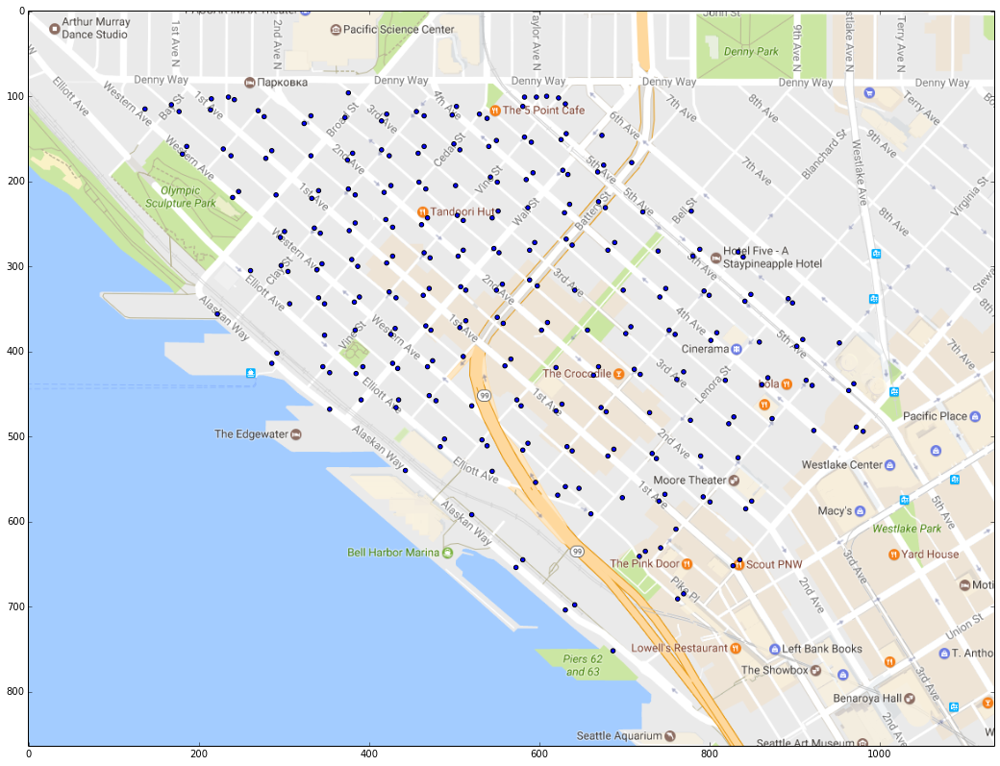

In [4]:
%matplotlib inline
import matplotlib.pyplot as plt
from scipy.misc import imread

fig = plt.figure(figsize=(18,16))
im = imread("belltown.png")
ax = plt.axes(xlim=(min(pixpos[:,0]), max(pixpos[:,0])), ylim=(min(pixpos[:,1]), max(pixpos[:,1])))
ax.cla()
ax.invert_yaxis()
plt.scatter(pixpos[:, 0], pixpos[:, 1])
plt.imshow(im)
plt.show()

Note that we need to flip the y-axis, since image pixel positions are enumerated with the origin at the top left. Of course, the equations in the MapOverlay class could be adjusted to place the origin at the bottom left, but nah.

Now we can simply take advantage of animation packages built on top of Matplotlib to create animated data visualizations on a static screencap of Google Maps. These animations were adapted from <a ref="http://jeffskinnerbox.me/notebooks/javascript-viewer-for-matplotlib-animations.html"> here </a> and the JSAnimation package from fellow UW Husky, Jake VanderPlas


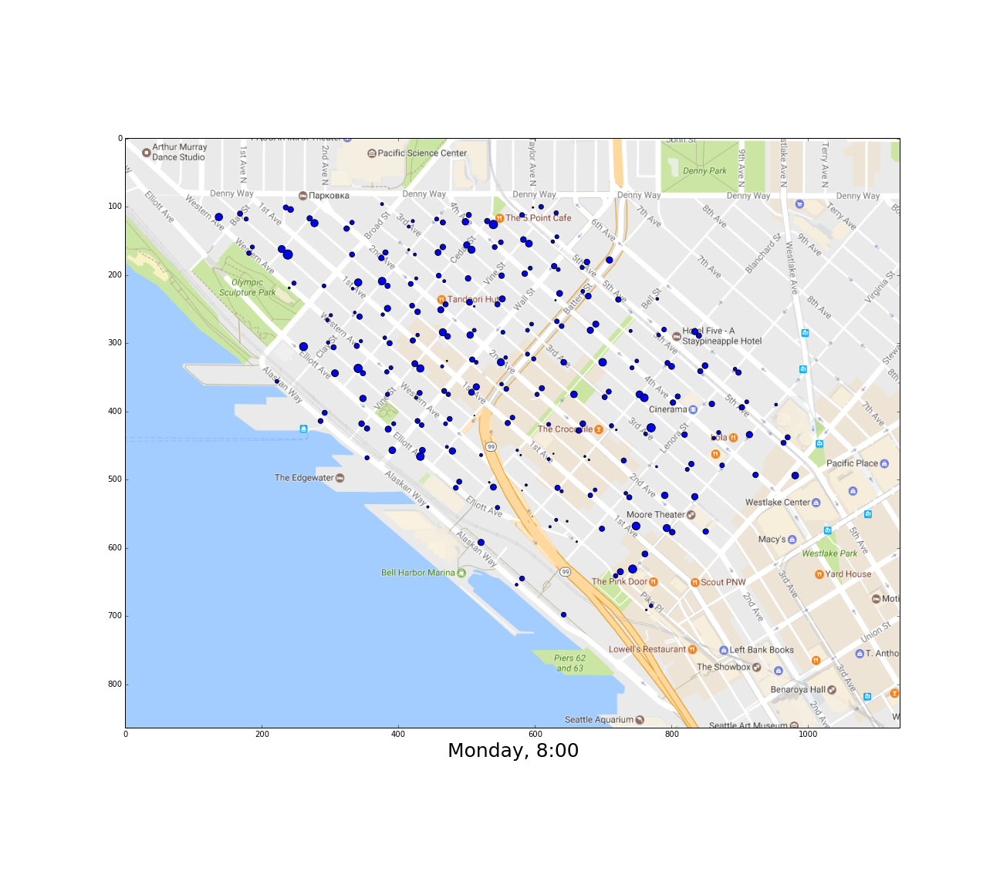
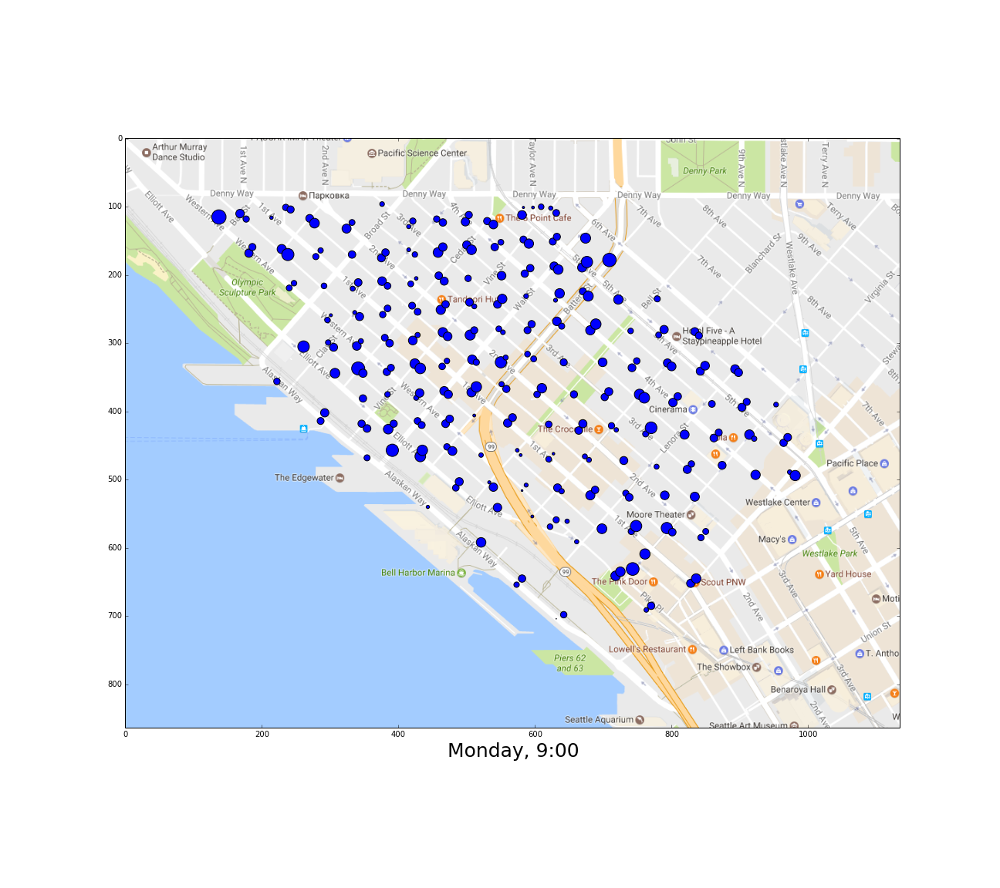
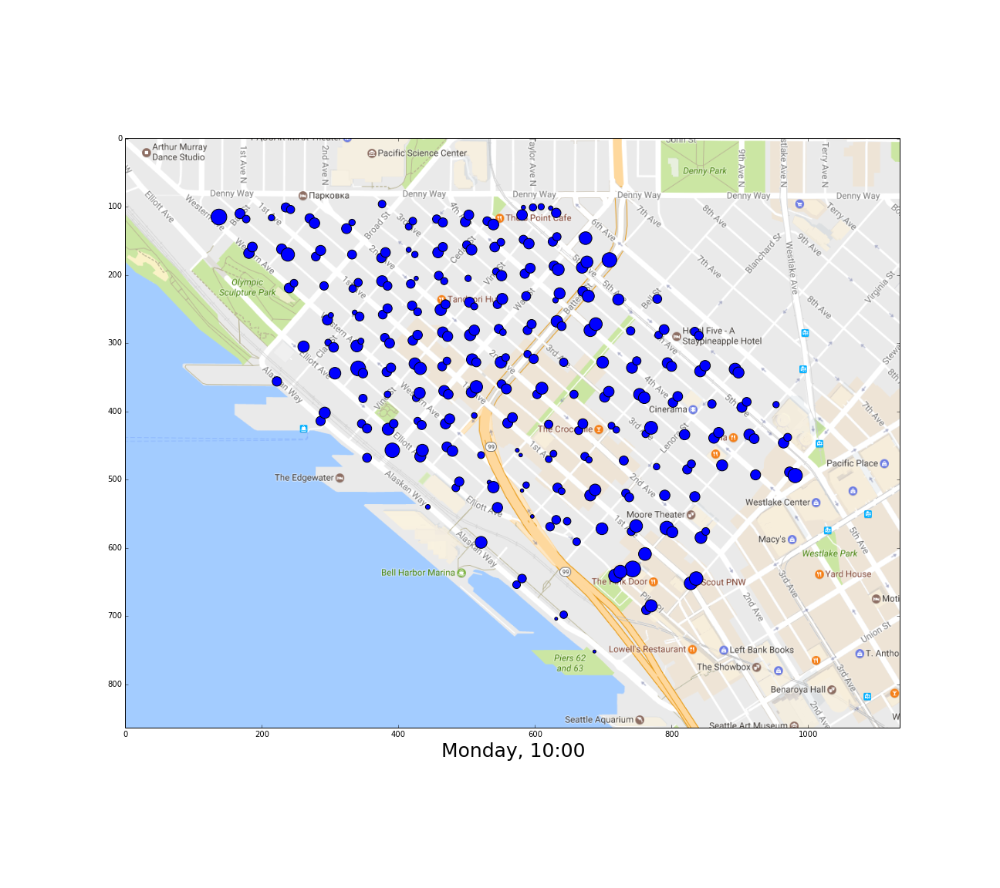
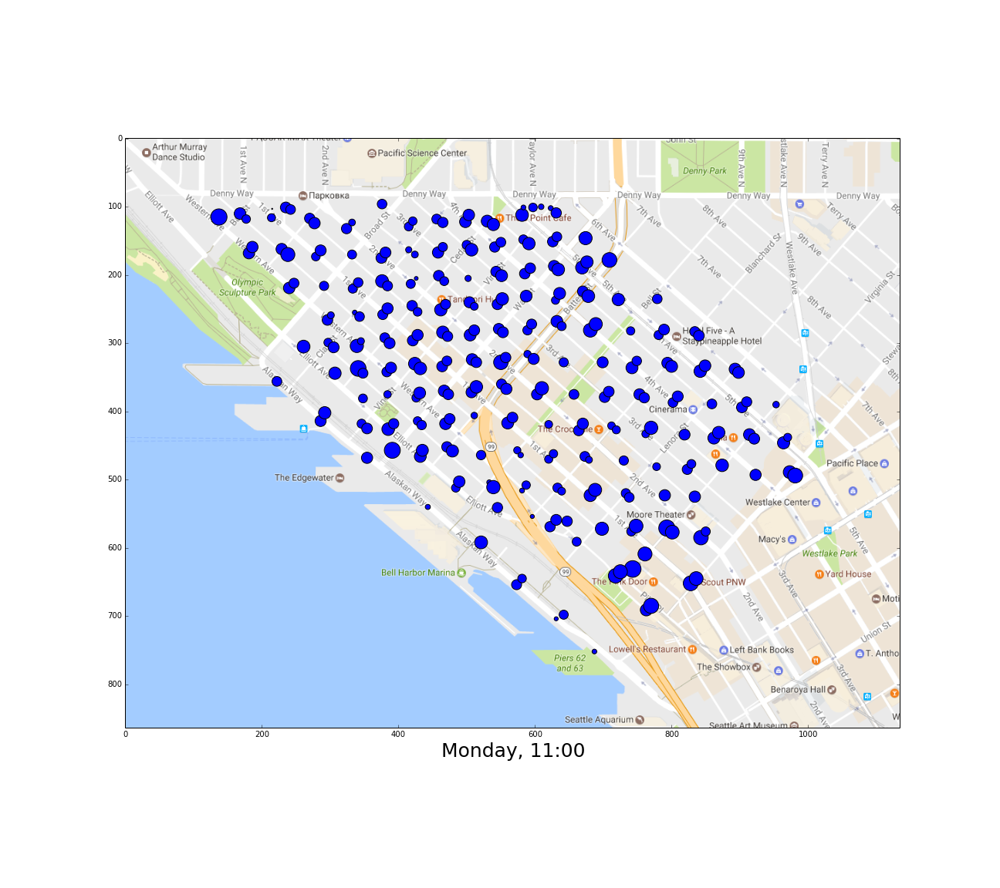
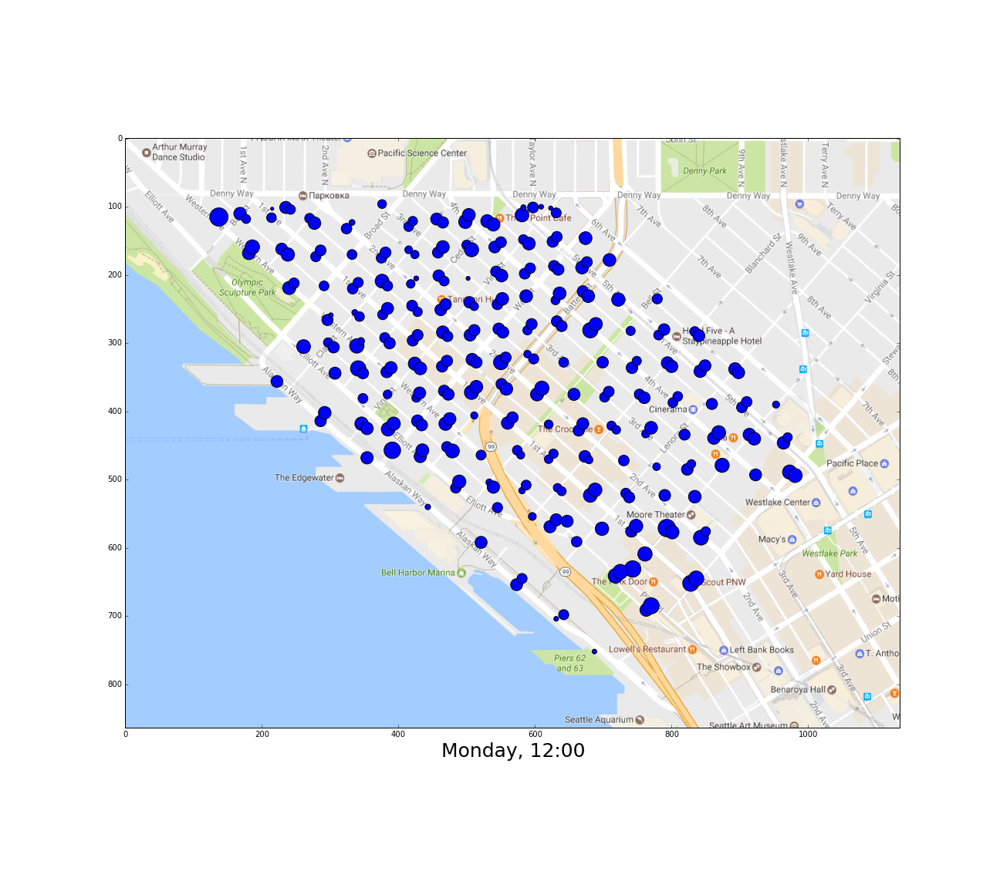
...
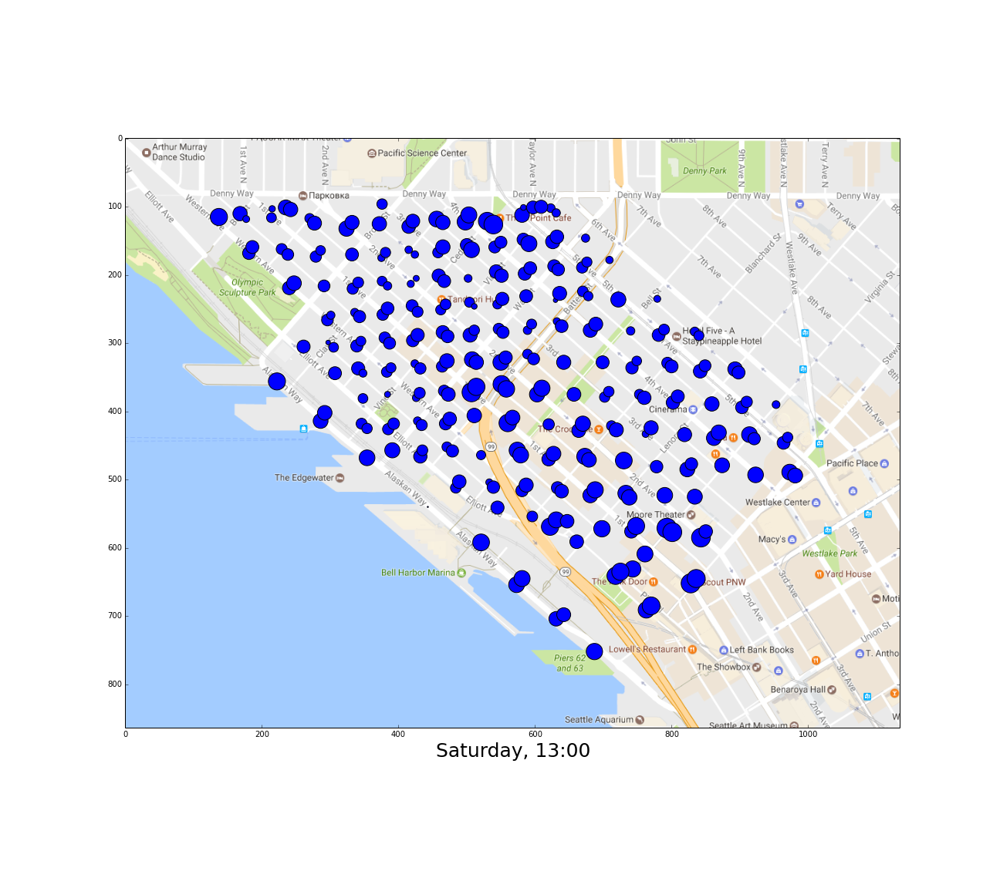
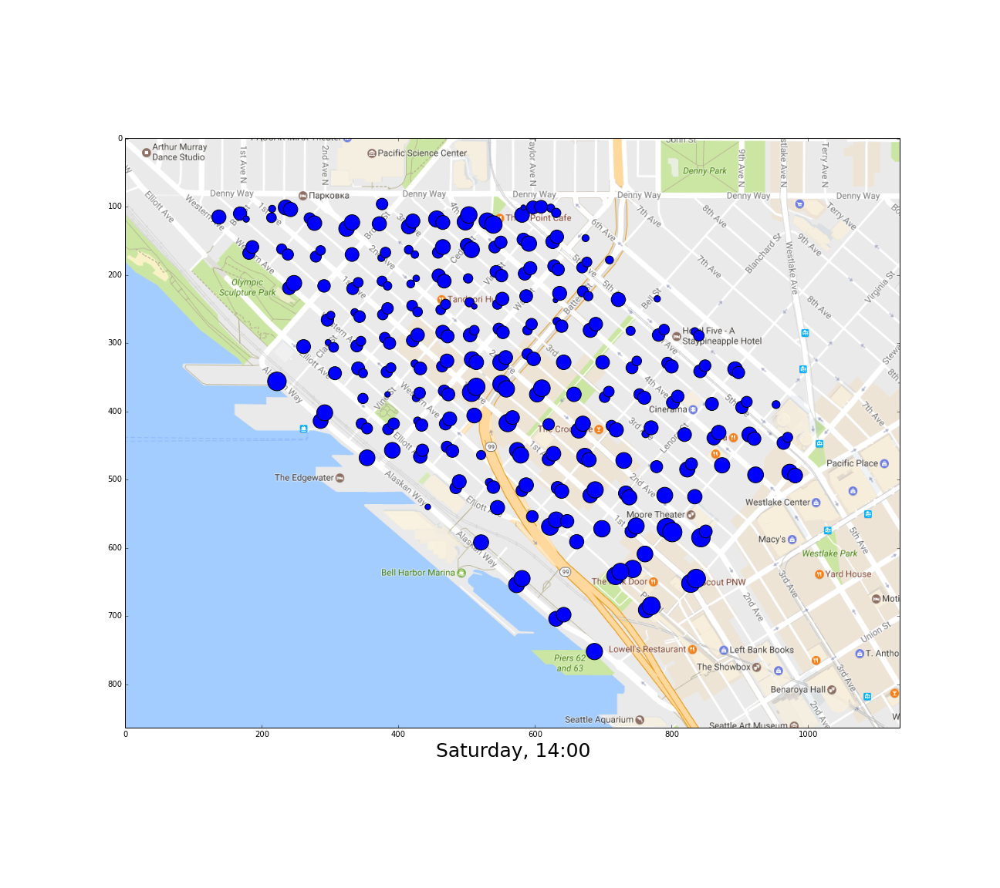
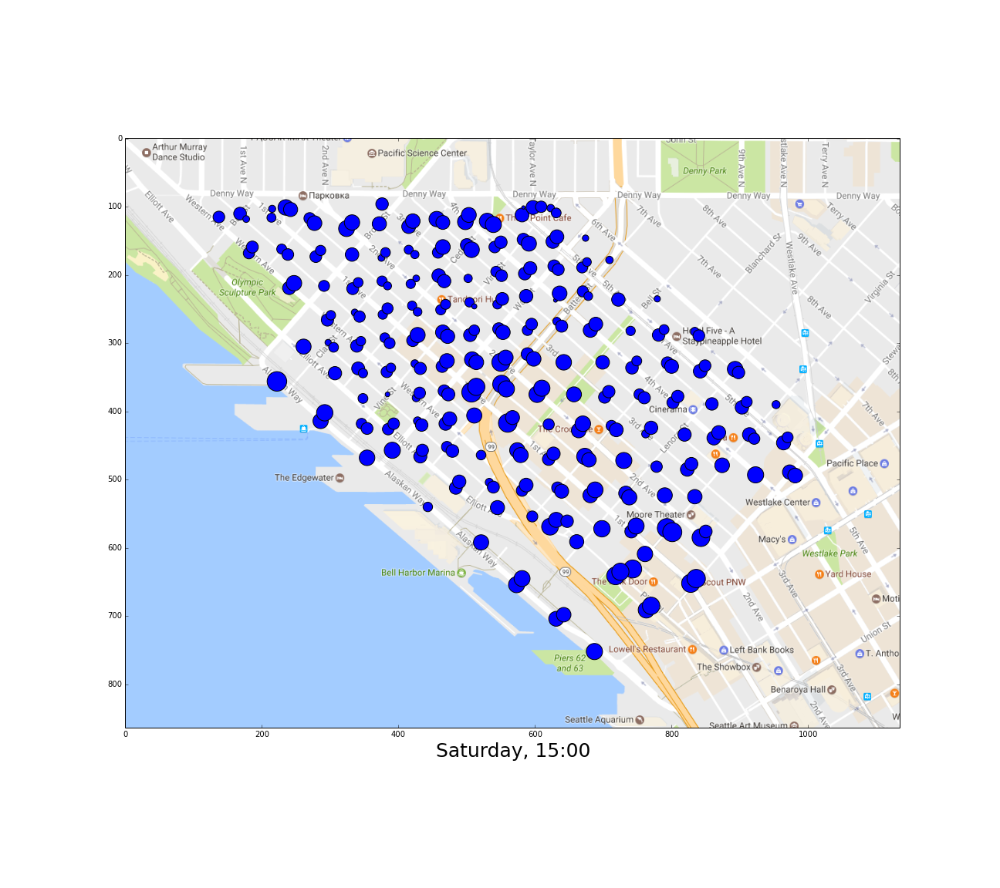
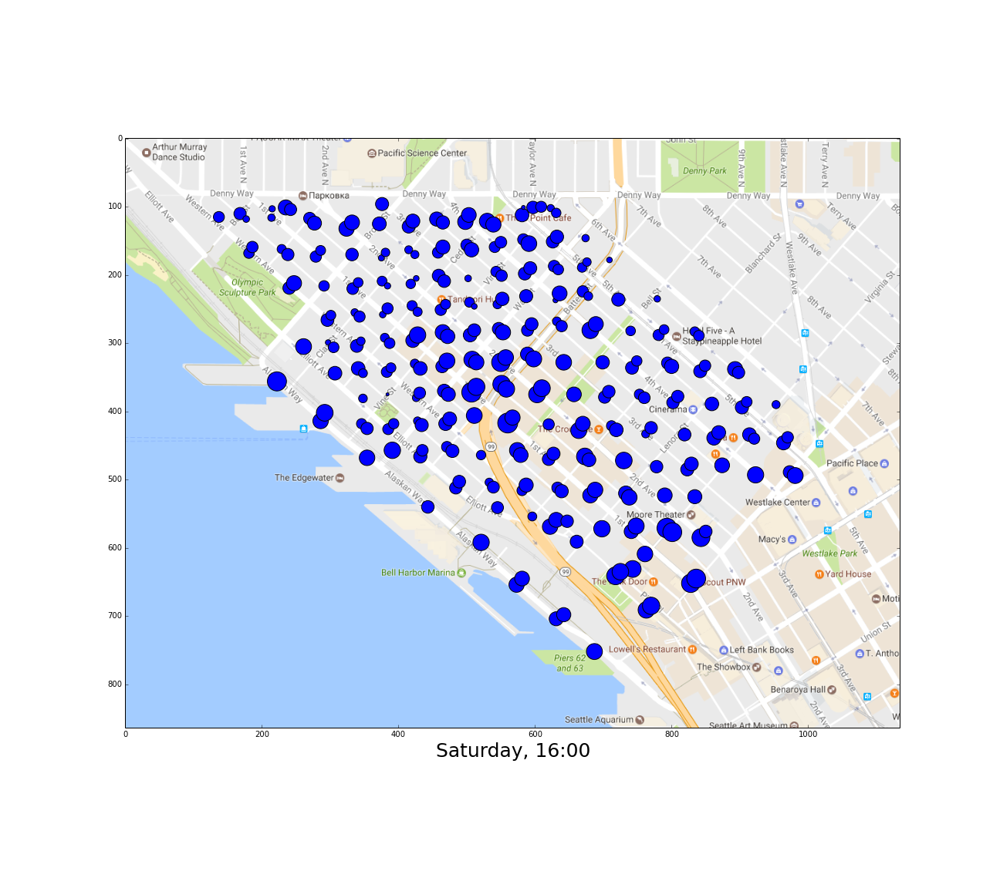
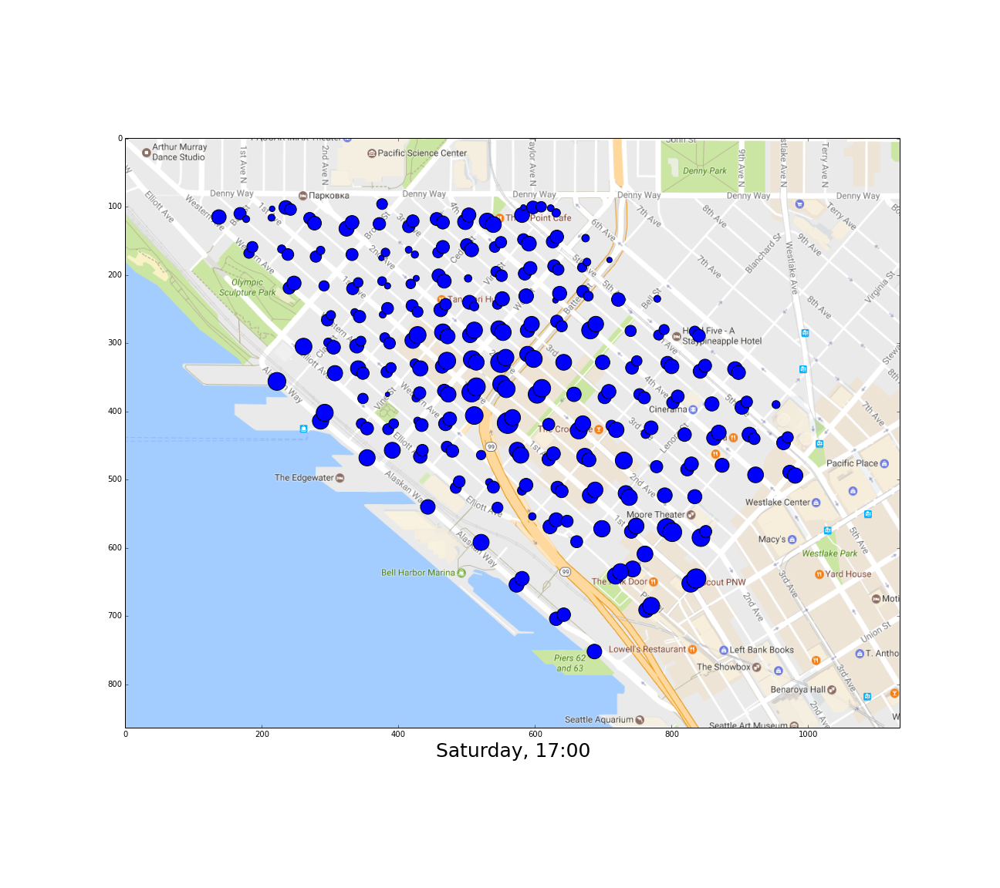

In [5]:
import sys
sys.path.append("./JSAnimation")
from JSAnimation import IPython_display #http://jeffskinnerbox.me/notebooks/javascript-viewer-for-matplotlib-animations.html
import matplotlib.pyplot as plt
from matplotlib import animation

times = []
for day in days:
    for hour in hours:
        times.append([day,hour])

fig = plt.figure(figsize=(18,16))
ax = plt.axes(xlim=(min(pixpos[:,0]), max(pixpos[:,0])), ylim=(min(pixpos[:,1]), max(pixpos[:,1])))
ax.invert_yaxis()
ax.xaxis.label.set_fontsize(25)
im = imread("belltown.png")

def init():
    return

def animate(i):
    t = times[i]
    weights = np.asarray([ hourlyAvgUtilization[t[0]][ek][t[1]] for ek in ekeys ])
    ax.cla()
    ax.scatter(pixpos[:, 0], pixpos[:, 1], s=500*weights)
    ax.set_xlabel(t[0] + ", " + str(t[1]) + ":00")
    ax.imshow(im)
    return

animation.FuncAnimation(fig, animate, init_func=init,
                        frames=len(times), interval=200, blit=True)